In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotting import CandlePlot
import numpy as np

from simulation.pair_trade_percent_binance import PairTradePercent
from technicals.indicators import Donchian_Close

from functools import reduce

In [3]:

from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')

In [4]:

# def calculate_rsi(df, period=14):
#     # Calcula as diferenças dos preços de fechamento
#     df['Price Change'] = df['Close'].diff()
    
#     # Separa ganhos e perdas
#     df['Gain'] = df['Price Change'].apply(lambda x: x if x > 0 else 0)
#     df['Loss'] = df['Price Change'].apply(lambda x: -x if x < 0 else 0)
    
#     # Calcula as médias móveis exponenciais dos ganhos e perdas
#     avg_gain = df['Gain'].rolling(window=period).mean()
#     avg_loss = df['Loss'].rolling(window=period).mean()
    
#     # Calcula o RSI
#     rs = avg_gain / avg_loss
#     df['RSI'] = 100 - (100 / (1 + rs))
    
#     # Limpa colunas temporárias
#     df.drop(columns=['Price Change', 'Gain', 'Loss'], inplace=True)
    
#     return df




# def calculate_adx(df, period=14):
#     # Cálculo de +DM, -DM e TR
#     df['High-Low'] = df['High'] - df['Low']
#     df['High-Close'] = abs(df['High'] - df['Close'].shift(1))
#     df['Low-Close'] = abs(df['Low'] - df['Close'].shift(1))
    
#     df['TR'] = df[['High-Low', 'High-Close', 'Low-Close']].max(axis=1)
#     df['+DM'] = np.where((df['High'] - df['High'].shift(1)) > (df['Low'].shift(1) - df['Low']), 
#                          np.maximum(df['High'] - df['High'].shift(1), 0), 0)
#     df['-DM'] = np.where((df['Low'].shift(1) - df['Low']) > (df['High'] - df['High'].shift(1)), 
#                          np.maximum(df['Low'].shift(1) - df['Low'], 0), 0)
    
#     # Suavizando os valores de TR, +DM e -DM com média móvel exponencial
#     df['TR_smooth'] = df['TR'].rolling(window=period).sum()
#     df['+DM_smooth'] = df['+DM'].rolling(window=period).sum()
#     df['-DM_smooth'] = df['-DM'].rolling(window=period).sum()
    
#     # Cálculo de +DI e -DI
#     df['+DI'] = 100 * (df['+DM_smooth'] / df['TR_smooth'])
#     df['-DI'] = 100 * (df['-DM_smooth'] / df['TR_smooth'])
    
#     # Cálculo do DX
#     df['DX'] = 100 * abs(df['+DI'] - df['-DI']) / (df['+DI'] + df['-DI'])
    
#     # Cálculo do ADX
#     df['ADX'] = df['DX'].rolling(window=period).mean()

#     # Limpando colunas temporárias
#     df.drop(columns=['High-Low', 'High-Close', 'Low-Close', 'TR', '+DM', '-DM', 'TR_smooth', '+DM_smooth', '-DM_smooth', 'DX'], inplace=True)

#     return df
    
# # Função para calcular a variação percentual acumulada
# def calculate_percent_change(close_prices, window):
#     percent_change = np.zeros(len(close_prices))

#     for i in range(window, len(close_prices)):
#         window_sum = 0.0
#         for j in range(i - window + 1, i + 1):
#             percent_change[j] = (close_prices[j] - close_prices[j - 1]) / close_prices[j - 1] * 100
#             window_sum += percent_change[j]
#         percent_change[i] = window_sum

#     return percent_change


# Função para calcular a variação percentual acumulada com uma janela deslizante correta
def calculate_percent_change(close_prices, window):
    percent_change = np.zeros(len(close_prices))

    for i in range(window, len(close_prices)):
        window_sum = 0.0
        for j in range(i - window + 1, i + 1):
            # Calcula a variação percentual entre o ponto atual e o ponto anterior
            change = (close_prices[j] - close_prices[j - 1]) / close_prices[j - 1] * 100
            window_sum += change
        # Atribui o valor acumulado da janela atual ao ponto final da janela
        percent_change[i] = window_sum

    return percent_change



# Função para calcular a EMA
def calculate_ema(values, period):
    ema = np.zeros(len(values))
    multiplier = 2 / (period + 1)
    ema[period - 1] = values[period - 1]  # O primeiro valor da EMA é igual ao valor inicial
    for i in range(period, len(values)):
        ema[i] = (values[i] - ema[i - 1]) * multiplier + ema[i - 1]
    return ema

# Função para calcular os indicadores e adicionar ao DataFrame
def calculate_indicators(df, window=14, ema_period_1=10, ema_period_2=60):
    
    # Obtém os preços de fechamento da coluna 'mid_c'
    close_prices = df['EMA_short'].values
    # close_prices = df['cLog_Returns'].values
    
    # Calcula a variação percentual acumulada
    percent_change = calculate_percent_change(close_prices, window)

    # Calcula as EMAs
    ema_1 = calculate_ema(percent_change, ema_period_1)
    ema_ema_1 = calculate_ema(ema_1, ema_period_2)
    # ema_2 = calculate_ema(percent_change, ema_period_2)

    # Adiciona os resultados ao DataFrame original
    df['Percent_Change'] = percent_change
    df['EMA_percent_s'] = ema_1
    df['double_EMA_percent_s'] = ema_ema_1
    # df['EMA_percent_l'] = ema_2

    return df


# Função para calcular os indicadores e adicionar ao DataFrame
def calculate_emaper(df, window=14):
    
    # Obtém os preços de fechamento da coluna 'mid_c'
    close_prices = df['EMA_short'].values
    # close_prices = df['cLog_Returns'].values
    
    # Calcula a variação percentual acumulada
    percent_change = calculate_percent_change(close_prices, window)

    # Calcula as EMAs
    # ema_1 = calculate_ema(percent_change, ema_period_1)
    # ema_ema_1 = calculate_ema(ema_1, ema_period_2)
    # ema_2 = calculate_ema(percent_change, ema_period_2)

    # # Adiciona os resultados ao DataFrame original
    # df['Percent_Change'] = percent_change
    # df['EMA_percent_s'] = ema_1
    # df['double_EMA_percent_s'] = ema_ema_1
    # df['EMA_percent_l'] = ema_2

    return percent_change
    


import pandas as pd
import numpy as np

def calculate_rsi(df, period=14):
    # Calcula as diferenças dos preços de fechamento
    delta = df['Close'].diff()
    
    # Separa ganhos e perdas
    gain = np.where(delta > 0, delta, 0)
    loss = np.where(delta < 0, -delta, 0)
    
    # Usa a média móvel exponencial para suavizar os ganhos e perdas
    avg_gain = pd.Series(gain).ewm(alpha=1/period, min_periods=period).mean()
    avg_loss = pd.Series(loss).ewm(alpha=1/period, min_periods=period).mean()
    
    # Calcula o RSI
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    
    # Adiciona o RSI ao DataFrame e retorna
    df['RSI'] = rsi
    return df

def calculate_adx(df, period=14):
    # Calcula +DM, -DM e TR
    high_diff = df['High'].diff()
    low_diff = df['Low'].diff()
    df['+DM'] = np.where((high_diff > low_diff) & (high_diff > 0), high_diff, 0)
    df['-DM'] = np.where((low_diff > high_diff) & (low_diff > 0), low_diff, 0)
    df['TR'] = np.maximum(df['High'] - df['Low'], 
                          np.maximum(abs(df['High'] - df['Close'].shift(1)), 
                                     abs(df['Low'] - df['Close'].shift(1))))

    # Suaviza TR, +DM e -DM com a média móvel exponencial
    atr = df['TR'].ewm(alpha=1/period, min_periods=period).mean()
    df['+DI'] = 100 * (df['+DM'].ewm(alpha=1/period, min_periods=period).mean() / atr)
    df['-DI'] = 100 * (df['-DM'].ewm(alpha=1/period, min_periods=period).mean() / atr)
    
    # Calcula o DX e o ADX
    dx = 100 * abs(df['+DI'] - df['-DI']) / (df['+DI'] + df['-DI'])
    df['ADX'] = dx.ewm(alpha=1/period, min_periods=period).mean()

    # Remove colunas temporárias
    df.drop(columns=['+DM', '-DM', 'TR'], inplace=True)
    
    return df


In [5]:
def run_pair(pair,
             granularity,
             ema_s=10,
             ema_l=200,
             lenght=10000,
             window_percent=100,
            ema_percent1=100,
            ema_percent2=100,
             strategy=1,
             EMA_percent_s_force=0.01,
             stop_loss_percent=-0.02,
             rsi_force=70,
             rsi_window=50,
             adx_force=20,
             adx_window=50
            ):
    df = pd.read_pickle(f"crypto/{pair}_{granularity}.pkl")
    df['time'] = df['Time'].copy()
    df['strategy'] = 0
    # dff['returns'] = dff['Close'].pct_change()
    df['returns'] = np.log(df['Close'] / df['Close'].shift(1))
    df['creturns'] = df['returns'].cumsum()
    df['Log_Returns'] = np.log(df['Close'] / df['Close'].shift(1))
    df['cLog_Returns'] = df['Log_Returns'].cumsum()

    # df = df.iloc[lenght:]
    df = df[df['Time'] >= lenght]

    df['EMA_short'] = df.Close.ewm(span=ema_s, min_periods=ema_s).mean()
    df['EMA_long'] = df.Close.ewm(span=ema_l, min_periods=ema_l).mean()

    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)
    
    # df = calculate_indicators(df, window_percent, ema_percent1, ema_percent2)

    # df['Percent_Change'] = calculate_emaper(df, window_percent)
    # df['EMA_percent_s'] = calculate_ema(df['Percent_Change'].values, ema_percent1)
    # df['double_EMA_percent_s'] =  calculate_ema(df['EMA_percent_s'].values,ema_percent2)

    df['Percent_Change_1'] = calculate_emaper(df, 1)
    df['EMA_percent_s_1'] = calculate_ema(df['Percent_Change_1'].values, 10)
    
    df['Percent_Change_10'] = calculate_emaper(df, 10)
    df['EMA_percent_s_10'] = calculate_ema(df['Percent_Change_10'].values, 10)

    df['Percent_Change_50'] = calculate_emaper(df, 50)
    df['EMA_percent_s_50'] = calculate_ema(df['Percent_Change_50'].values, 10)
    
    df['Percent_Change_150'] = calculate_emaper(df, 150)
    df['EMA_percent_s_150'] = calculate_ema(df['Percent_Change_150'].values, 10)

    df['Percent_Change_200'] = calculate_emaper(df, 200)
    df['EMA_percent_s_200'] = calculate_ema(df['Percent_Change_200'].values, 10)

    # df['Percent_Change_500'] = calculate_emaper(df, 500)
    # df['EMA_percent_s_500'] = calculate_ema(df['Percent_Change_500'].values, 10)

    # df['Percent_Change_1000'] = calculate_emaper(df, 1000)
    # df['EMA_percent_s_1000'] = calculate_ema(df['Percent_Change_1000'].values, 10)

    # df['Percent_Change_2000'] = calculate_emaper(df, 2000)
    # df['EMA_percent_s_2000'] = calculate_ema(df['Percent_Change_2000'].values, 10)
    
    
    df['Average_EMA_percent'] = df[['EMA_percent_s_50', 'EMA_percent_s_150', 'EMA_percent_s_200']].mean(axis=1)
    df['Average_EMA_percent_ema_short'] = calculate_ema(df['Average_EMA_percent'].values, ema_percent1)
    df['Average_EMA_percent_ema_long'] = calculate_ema(df['Average_EMA_percent'].values, ema_percent2)
    df['Average_EMA_percent_ema_1'] = calculate_ema(df['Average_EMA_percent'].values, 1)
    df['Average_EMA_percent_ema_5'] = calculate_ema(df['Average_EMA_percent'].values, 5)
    df['Average_EMA_percent_ema_50'] = calculate_ema(df['Average_EMA_percent'].values, 50)
    df['Average_EMA_percent_ema_100'] = calculate_ema(df['Average_EMA_percent'].values, 100)

    df = Donchian_Close(df, window_percent)
    
    df = calculate_adx(df, adx_window)
    df = calculate_rsi(df, rsi_window)
    
    df.dropna(inplace=True)
    
    df.reset_index(drop=True, inplace=True)


    

    
    gt = PairTradePercent(
        df,
        strategy,
        EMA_percent_s_force,
        stop_loss_percent,
        rsi_force,
        adx_force
    )
    
    gt.run_test()
    return gt
    

In [6]:
# df = run_pair(pair='BTCUSDT', 
#               granularity='1m', 
#               ema=10,
#               lenght=10000, 
#               pairs_trade_benchmark = ["BTCUSDT",'ETHUSDT','BNBUSDT','LTCUSDT'],
#             window_percent=100,
#             ema_percent1=100,
#             ema_percent2=100,)


In [7]:
# df.columns

In [8]:
# pairs = ["ADAUSDT","BTCUSDT",'ETHUSDT','BNBUSDT','XRPUSDT','LTCUSDT']
# pairs = ['BTCUSDT']
pairs = ['LINKUSDT','DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','LTCUSDT','TRXUSDT','XLMUSDT','AVAXUSDT']

In [9]:
def get_list_args():
    args_dic_list = []
    for ema_s in [10]:
        for ema_l in [5000]:
            for pair in pairs:
                for granularity in ['1m']:
                    for lenght in ['2022-01-01 00:00:00']:
                        for window_percent in [500]:
                            for ema_percent1 in [5,10,20,50]:
                                for ema_percent2 in [20,50,100]:
                                    if ema_percent1 < ema_percent2:
                                        for EMA_percent_s_force in [1,2,3,4,5]:
                                            for stop_loss_percent in [-0.01,-0.02,-0.03,-0.04]:
                                                for strategy in [14]:#,11,12]:
                                                    rsi_forces = [50]
                                                    rsi_windows = [50]
                                                    adx_forces = [20]
                                                    adx_windows = [50]
                                                    if strategy in [1,2,3]:
                                                        rsi_forces, rsi_windows, adx_forces, adx_windows = [10], [10], [10], [10]
                                                    elif strategy in [4,6,8]:
                                                        adx_forces, adx_windows = [10], [10]
                                                    elif strategy in [5,7,9]:
                                                        rsi_forces, rsi_windows = [10], [10]
                                                    for rsi_force in rsi_forces:
                                                        for rsi_window in rsi_windows:
                                                            for adx_force in adx_forces:
                                                                for adx_window in adx_windows:
                                                                
                                                                    args_dic = {"pair": pair,
                                                                                "granularity":granularity,
                                                                                'ema_s': ema_s,
                                                                                'ema_l': ema_l,
                                                                                'lenght': lenght,
                                                                                'window_percent': window_percent,
                                                                               'ema_percent1': ema_percent1,
                                                                               'ema_percent2': ema_percent2,
                                                                                'strategy':strategy,
                                                                               'EMA_percent_s_force':EMA_percent_s_force,
                                                                                'stop_loss_percent':stop_loss_percent,
                                                                               'rsi_force': rsi_force,
                                                                               'rsi_window':rsi_window,
                                                                               'adx_force': adx_force,
                                                                               'adx_window':adx_window}
                                                                    args_dic_list.append(args_dic)

    return args_dic_list

In [10]:

def run_process(L, arg):
    # print("PROCESS",arg)
    L.append(
        dict(
            arg=arg,
            pair=arg['pair'],
            granularity=arg['granularity'],
            ema_s=arg['ema_s'],
            ema_l=arg['ema_l'],
            lenght = arg['lenght'],
            window_percent = arg['window_percent'],
            ema_percent1 = arg['ema_percent1'],
            ema_percent2 = arg['ema_percent2'],
            stop_loss_percent = arg['stop_loss_percent'],
            strategy = arg['strategy'],
            rsi_force = arg['rsi_force'],
            rsi_window = arg['rsi_window'],
            adx_force = arg['adx_force'],
            adx_window = arg['adx_window'],
            res=run_pair(
                pair=arg['pair'],
                granularity=arg['granularity'],
                ema_s=arg['ema_s'],
                ema_l=arg['ema_l'],
                lenght = arg['lenght'],
                window_percent = arg['window_percent'],
                ema_percent1 = arg['ema_percent1'],
                ema_percent2= arg['ema_percent2'],
                strategy= arg['strategy'],
                EMA_percent_s_force=arg['EMA_percent_s_force'],
                stop_loss_percent=arg['stop_loss_percent'],
                rsi_force = arg['rsi_force'],
                rsi_window = arg['rsi_window'],
                adx_force=  arg['adx_force'],
                adx_window = arg['adx_window'],
            )
        )
    )


lista = []
def run_ema_macd():
    with Manager() as manager:
        global lista
        L = manager.list()  # <-- can be shared between processes.
        args_list = get_list_args()
        print(len(args_list))
        limit = 10
        current = 0
    
        while current < len(args_list):
            print(current)
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L,args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()

        print("ALL DONE")
        lista = list(L)
        

In [ ]:
%%time

run_ema_macd()

1620
0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390


In [12]:
# ddf = lista[0]['res'].df.copy()

In [7]:
# with open(f"./result-binance-acumulative-percentual-new-data-strategy-14-1min.pkl", "wb") as f:
#     pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo



In [8]:
# listaa = []

# # Carregar os arquivos e expandir seus conteúdos diretamente na lista principal
# for filename in [
#     "./result-binance-acumulative-percentual-strategy-1-2-3-4-5.pkl",
#     "./result-binance-acumulative-percentual-strategy-6-7-8-9.pkl",
#     "./result-binance-acumulative-percentual-strategy-10-11-12.pkl"
# ]:
#     with open(filename, "rb") as f:
#         listaa.extend(pickle.load(f))
        
# with open(f"./result-binance-acumulative-percentual-strategy-1-12.pkl", "wb") as f:
#     pickle.dump(listaa, f)  # Usa o pickle para salvar o arquivo



In [9]:
# ddf.columns

In [10]:
# ddf.describe()

In [11]:
# cp = CandlePlot(ddf.iloc[40000:80000],candles=False)


# trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP == 1]

# trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN == 1]

# print(len(trades_up),len(trades_down))

In [12]:

# marker_trade_up = '#abebc6'
# marker_trade_down = '#cccddd'


# markers = 'Close'


# cp.add_traces(['Close','EMA_long'])


# # # SIGNAL UP
# cp.fig.add_trace(go.Scatter(
#     x = trades_up.sTime,
#     y = trades_up[markers],
#     mode = 'markers',
#     marker_symbol = 'triangle-up',
#     marker=dict(color=marker_trade_up, size=12)
# ))

# cp.fig.add_trace(go.Scatter(
#     x = trades_down.sTime,
#     y = trades_down[markers],
#     mode = 'markers',
#     marker_symbol = 'triangle-down',
#     marker=dict(color=marker_trade_down, size=12)
# ))


# cp.show_plot(height=700, width=1100, sec_traces=['EMA_percent_s','EMA_percent_l'])

In [7]:
# res = lista

with open(f"result-binance-acumulative-percentual-st-14.pkl", "rb") as f:
    res = pickle.load(f)

In [8]:

dic_res = []
for r in res:

    if r['res'].len_close > 0:
        signal_up = r['res'].df_results.SIGNAL_UP.values[-1]
        res_pos = r['res'].df_results[r['res'].df_results['result'] > 0]
        res_neg = r['res'].df_results[r['res'].df_results['result'] <= 0]
        sum_neg = res_neg.result.sum() * -1
        sum_pos = res_pos.result.sum()

        res_pos_s = r['res'].df_results[r['res'].df_results['strategy'] > 0]
        res_neg_s = r['res'].df_results[r['res'].df_results['strategy'] <= 0]
        sum_neg_s = res_neg_s.strategy.sum() *-1
        sum_pos_s = res_pos_s.strategy.sum()
        dic_res.append(
            dict(
                pair = r['pair'],
                granularity = r['granularity'],
                ema_s = r['ema_s'],
                ema_l = r['ema_l'],
                strat = round(r['res'].df_results.strategy.sum(),3),
                res = round(r['res'].df_results.result.sum(),3),
                sig = signal_up,
                c = r['res'].df_results['count'].mean(),
                wp = r['window_percent'],
                ep = r['ema_percent1'],
                ep2 = r['ema_percent2'],
                rsi_f = r['rsi_force'],
                rsi_w = r['rsi_window'],
                adx_f = r['adx_force'],
                adx_w = r['adx_window'],
                
                max_o = max(r['res'].df_results.total_opened),
                st = r['res'].strategy,
                force = r['res'].EMA_percent_s_force,
                sl_per = r['res'].stop_loss_percent,
                              
                s_p_strat = sum_pos_s,
                s_n_strat = sum_neg_s,
                Rel_sum = sum_pos_s/(sum_pos_s+ sum_neg_s),
                
                l_p_strat = len(res_pos_s),
                l_n_strat = len(res_neg_s),
                Rel_len = len(res_pos_s)/(len(res_pos_s)+ len(res_neg_s)),
                
                l_c = r['res'].len_close,
                l_o = r['res'].len_open,
                   
                len_pos = len(res_pos),
                len_neg = len(res_neg),
                sum_pos = sum_pos,
                sum_neg = sum_neg,
                Rel_len_pos_neg = len(res_pos)/(len(res_pos)+ len(res_neg)),
                Rel_pos_neg = sum_pos/(sum_pos+ sum_neg),

                first_p = r['res'].first_price,
                last_p = r['res'].last_price,

                first_t = r['res'].df_results.start_time.values[0],
                last_t = r['res'].df_results.end_time.values[-1],
                
                r = r['res'].df_results,
                # df = r['res'].df
            )
    )
    # print(f"p={p}  e={e}  dw={dw}  dwp={dwp}   strategy={st}   result={result}")


In [9]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [10]:
df_res = pd.DataFrame(dic_res)

In [11]:
df_res.head(50)

,pair,granularity,ema_s,ema_l,strat,res,sig,c,wp,ep,ep2,rsi_f,rsi_w,adx_f,adx_w,max_o,st,force,sl_per,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_p,last_p,first_t,last_t,r
0,ADAUSDT,1m,10,5000,-0.179,0.314,1,142.504476,500,5,20,50,50,20,50,5,14,1,-0.02,5.396827,5.575788,0.491845,1297,267,0.829284,1564,0,1123,441,2.9763,2.6623,0.718031,0.527844,0.572,0.3733,2024-01-05 02:11:00,2024-09-30 23:33:00,running start_index_m5 count trigger_...
1,ADAUSDT,1m,10,5000,-0.008,0.293,1,286.822777,500,5,20,50,50,20,50,7,14,1,-0.04,5.623634,5.631383,0.499656,1426,137,0.912348,1563,1,1212,351,3.0631,2.7698,0.775432,0.525142,0.572,0.3733,2024-01-05 02:11:00,2024-09-30 22:58:00,running start_index_m5 count trigger_...
2,ADAUSDT,1m,10,5000,-0.127,0.016,0,46.378788,500,5,20,50,50,20,50,3,14,2,-0.01,1.418751,1.546017,0.478537,322,140,0.696970,462,0,278,184,0.7421,0.7262,0.601732,0.505414,0.572,0.3733,2024-01-05 02:11:00,2024-09-26 09:14:00,running start_index_m5 count trigger_t...
3,ADAUSDT,1m,10,5000,-0.247,-0.004,0,109.235931,500,5,20,50,50,20,50,4,14,2,-0.02,1.470329,1.717219,0.461273,381,81,0.824675,462,0,314,148,0.8222,0.8261,0.679654,0.498817,0.572,0.3733,2024-01-05 02:11:00,2024-09-26 11:38:00,running start_index_m5 count trigger_t...
4,ADAUSDT,1m,10,5000,0.036,0.024,0,77.798742,500,5,20,50,50,20,50,3,14,3,-0.02,0.562343,0.526197,0.516603,134,25,0.842767,159,0,103,56,0.3069,0.2833,0.647799,0.519993,0.572,0.3733,2024-01-06 07:15:00,2024-09-19 01:18:00,running start_index_m5 count trigger_t...
5,ADAUSDT,1m,10,5000,0.262,0.142,0,204.571429,500,5,20,50,50,20,50,4,14,2,-0.03,1.824507,1.562289,0.538712,412,50,0.891775,462,0,336,126,0.9455,0.8038,0.727273,0.540502,0.572,0.3733,2024-01-05 02:11:00,2024-09-26 11:38:00,running start_index_m5 count trigger_t...
6,ADAUSDT,1m,10,5000,-0.333,0.202,1,69.434783,500,5,20,50,50,20,50,4,14,1,-0.01,4.634490,4.967215,0.482674,1111,453,0.710358,1564,0,1002,562,2.4643,2.2627,0.640665,0.521324,0.572,0.3733,2024-01-05 02:11:00,2024-09-30 22:58:00,running start_index_m5 count trigger_...
7,ADAUSDT,1m,10,5000,0.060,0.018,0,36.716981,500,5,20,50,50,20,50,2,14,3,-0.01,0.573461,0.513687,0.527491,113,46,0.710692,159,0,94,65,0.2850,0.2673,0.591195,0.516024,0.572,0.3733,2024-01-06 07:15:00,2024-09-19 01:18:00,running start_index_m5 count trigger_t...
8,ADAUSDT,1m,10,5000,0.149,0.073,0,247.214286,500,5,20,50,50,20,50,5,14,2,-0.04,1.629916,1.481148,0.523909,426,36,0.922078,462,0,346,116,0.8875,0.8145,0.748918,0.521445,0.572,0.3733,2024-01-05 02:11:00,2024-09-26 11:38:00,running start_index_m5 count trigger_t...
9,ADAUSDT,1m,10,5000,0.142,0.335,1,230.234165,500,5,20,50,50,20,50,6,14,1,-0.03,5.741909,5.599808,0.506265,1382,181,0.884197,1563,1,1179,384,3.0687,2.7342,0.754319,0.528822,0.572,0.3733,2024-01-05 02:11:00,2024-09-30 14:59:00,running start_index_m5 count trigger_...


In [12]:
df_res.iloc[0].r.describe()

,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time
count,1564.000000,1564.000000,1564.0,1564.000000,1564.000000,1564.000000,1564.000000,1.564000e+03,1564.000000,1564.000000,1564.000000,1564.000000,1564.000000,1564.000000,1564.000000,1564,1564
mean,182089.937340,142.504476,0.0,-0.000114,0.000300,1.615090,0.829284,-2.000000e-02,0.024361,0.000460,0.487998,0.488004,0.514706,0.485294,0.000201,2024-05-10 08:49:26.508951552,2024-05-10 06:27:56.240409344
min,393.000000,4.000000,0.0,-0.050303,-0.049503,1.000000,0.000000,-2.000000e-02,0.020000,-0.020000,0.288100,0.282400,0.000000,0.000000,-0.025400,2024-01-05 02:16:00,2024-01-05 02:11:00
25%,88743.500000,31.000000,0.0,0.000200,-0.000166,1.000000,1.000000,-2.000000e-02,0.020000,0.001000,0.387900,0.387400,0.000000,0.000000,-0.000100,2024-03-06 13:45:15,2024-03-06 10:41:30
50%,159859.000000,75.000000,0.0,0.000200,0.000885,1.000000,1.000000,-2.000000e-02,0.020000,0.001000,0.464000,0.463000,1.000000,0.000000,0.000400,2024-04-24 22:01:00,2024-04-24 19:57:00
75%,286534.750000,175.000000,0.0,0.000844,0.001644,2.000000,1.000000,-2.000000e-02,0.020000,0.001000,0.581225,0.581700,1.000000,1.000000,0.000800,2024-07-21 23:09:45,2024-07-21 19:12:45
max,388603.000000,1703.000000,0.0,0.102351,0.102626,5.000000,1.000000,-2.000000e-02,0.160000,0.103151,0.801000,0.795600,1.000000,1.000000,0.047500,2024-09-30 23:33:00,2024-09-30 16:21:00
std,112083.019029,178.156851,0.0,0.012648,0.012542,0.813468,0.376381,3.470557e-18,0.013599,0.012472,0.121923,0.121979,0.499944,0.499944,0.006275,NaN,NaN


In [13]:
df_res.iloc[0].r.head()

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time
0,False,393,6,0,0.0002,-0.000361,1,False,1,-0.02,0.02,0.001,buy,0.5538,0.5536,1,0,-0.0002,2024-01-05 02:16:00,2024-01-05 02:11:00
1,False,447,30,0,0.0002,0.000903,2,False,1,-0.02,0.02,0.001,buy,0.5536,0.5541,1,0,0.0005,2024-01-05 03:34:00,2024-01-05 03:05:00
2,False,500,155,0,0.0002,0.000724,3,False,1,-0.02,0.02,0.001,buy,0.5526,0.5530,1,0,0.0004,2024-01-05 06:32:00,2024-01-05 03:58:00
3,False,422,390,0,0.0002,0.000180,2,False,1,-0.02,0.02,0.001,buy,0.5552,0.5553,1,0,0.0001,2024-01-05 09:09:00,2024-01-05 02:40:00
4,False,526,384,0,0.0002,0.000910,1,False,1,-0.02,0.02,0.001,buy,0.5491,0.5496,1,0,0.0005,2024-01-05 10:47:00,2024-01-05 04:24:00


In [14]:
df_sorted_desc = df_res.sort_values(by=['pair','strat'], ascending=False)

In [15]:
# Exibir todas as linhas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

df_sorted_desc.head(10)

,pair,granularity,ema_s,ema_l,strat,res,sig,c,wp,ep,ep2,rsi_f,rsi_w,adx_f,adx_w,max_o,st,force,sl_per,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_p,last_p,first_t,last_t,r
797,XRPUSDT,1m,10,5000,0.582,0.326,1,334.252809,500,10,50,50,50,20,50,4,14,2,-0.04,0.945772,0.363390,0.722425,169,9,0.949438,178,0,132,46,0.5381,0.2121,0.741573,0.717275,0.5868,0.6114,2024-01-07 23:56:00,2024-09-30 11:53:00,running start_index_m5 count trigger_t...
803,XRPUSDT,1m,10,5000,0.566,0.308,1,169.606742,500,10,50,50,50,20,50,3,14,2,-0.03,1.069472,0.503591,0.679866,162,16,0.910112,178,0,129,49,0.6025,0.2949,0.724719,0.671384,0.5868,0.6114,2024-01-07 23:56:00,2024-09-30 11:53:00,running start_index_m5 count trigger_t...
736,XRPUSDT,1m,10,5000,0.550,0.313,0,286.764398,500,5,50,50,50,20,50,4,14,2,-0.04,0.997873,0.447599,0.690344,180,11,0.942408,191,0,148,43,0.5754,0.2627,0.774869,0.686553,0.5868,0.6114,2024-01-07 23:53:00,2024-09-30 12:48:00,running start_index_m5 count trigger_t...
841,XRPUSDT,1m,10,5000,0.497,0.303,1,213.225806,500,20,50,50,50,20,50,3,14,2,-0.04,0.741150,0.244500,0.751940,149,6,0.961290,155,0,129,26,0.4438,0.1405,0.832258,0.759541,0.5868,0.6114,2024-01-08 00:01:00,2024-09-30 13:20:00,running start_index_m5 count trigger_t...
823,XRPUSDT,1m,10,5000,0.454,0.327,1,414.657732,500,10,100,50,50,20,50,5,14,1,-0.04,1.938360,1.484558,0.566289,449,36,0.925773,485,0,378,107,1.1678,0.8404,0.779381,0.581516,0.5868,0.6114,2024-01-05 02:48:00,2024-09-30 16:54:00,running start_index_m5 count trigger_t...
744,XRPUSDT,1m,10,5000,0.443,0.252,1,184.837696,500,5,50,50,50,20,50,3,14,2,-0.03,1.008601,0.565425,0.640778,172,19,0.900524,191,0,142,49,0.5826,0.3307,0.743455,0.637906,0.5868,0.6114,2024-01-07 23:53:00,2024-09-30 11:39:00,running start_index_m5 count trigger_t...
737,XRPUSDT,1m,10,5000,0.436,0.413,1,416.933950,500,5,50,50,50,20,50,7,14,1,-0.04,3.472836,3.036514,0.533515,682,75,0.900925,757,0,583,174,2.0733,1.6599,0.770145,0.555368,0.5868,0.6114,2024-01-05 02:41:00,2024-09-30 22:17:00,running start_index_m5 count trigger_t...
845,XRPUSDT,1m,10,5000,0.436,0.267,1,166.019355,500,20,50,50,50,20,50,3,14,2,-0.03,0.811381,0.375285,0.683748,142,13,0.916129,155,0,124,31,0.4820,0.2146,0.800000,0.691932,0.5868,0.6114,2024-01-08 00:01:00,2024-09-30 13:20:00,running start_index_m5 count trigger_t...
784,XRPUSDT,1m,10,5000,0.407,0.245,1,301.849057,500,10,20,50,50,20,50,5,14,2,-0.04,1.226621,0.819829,0.599390,245,20,0.924528,265,0,204,61,0.7149,0.4699,0.769811,0.603393,0.5868,0.6114,2024-01-05 02:17:00,2024-09-30 13:59:00,running start_index_m5 count trigger_t...
724,XRPUSDT,1m,10,5000,0.368,0.224,1,258.940972,500,5,20,50,50,20,50,5,14,2,-0.04,1.246170,0.878333,0.586570,266,22,0.923611,288,0,214,74,0.7296,0.5058,0.743056,0.590578,0.5868,0.6114,2024-01-05 02:37:00,2024-09-30 13:53:00,running start_index_m5 count trigger_t...


In [16]:
df_sorted_desc.iloc[4].r['time'] = df_sorted_desc.iloc[4].r['end_time']
df_sorted_desc.iloc[4].r['GAIN_C'] = df_sorted_desc.iloc[4].r.strategy.cumsum()

cp = CandlePlot(df_sorted_desc.iloc[4].r, candles=False)
cp.show_plot(line_traces = ['GAIN_C'])

In [17]:
def rank_backtest_results(df):
    # Definindo pesos para cada coluna com base na importância
    weights = {
        # 'Rel_len_pos_neg':1,
        # 'res': 0.5,
        # 'Rel_len':0.5,
        'strat': 0.4,           # Retorno acumulado percentual (maximizar)
        # 'Rel_len': 0.3,      # Relação de trades positivos/negativos (maximizar)
        # 'Rel_sum': 0.1,        # Relação de resultados positivos/negativos (maximizar)
        # 'l_p_s': 0.1,            # Quantidade de trades positivos (maximizar)
        # 'l_n_s': -0.1,           # Quantidade de trades negativos (minimizar)
        # 's_p_s': 0.05,           # Soma dos retornos positivos (maximizar)
        # 's_n_s': -0.05,          # Soma dos retornos negativos (minimizar)
        # 'c': -0.05,          # Média de candles até TP ou SL (minimizar)
        # 'max_o': -0.1,       # Máximo de operações abertas ao mesmo tempo (minimizar)
        # 'ema': -0.01,            # EMA short (minimizar)
        # 'tp': 0.1,             # Take profit percentual (minimizar)
        # 'sl': -0.05,             # Stop loss percentual (minimizar)
        # 'dw': -0.01              # Janela Donchian (minimizar)
    }
    
    # Normalizando as colunas relevantes
    for col in weights.keys():
        df[col + '_norm'] = (df[col] - df[col].min()) / (df[col].max() - df[col].min())
    
    # Calculando o score ponderado para cada linha
    df['score'] = sum(
        df[col + '_norm'] * weight if weight >= 0 else (1 - df[col + '_norm']) * abs(weight) 
        for col, weight in weights.items()
    )
    
    # Ordenando o DataFrame pelos melhores resultados com base no score
    df_sorted = df.sort_values(by='score', ascending=False).reset_index(drop=True)
    
    # Removendo colunas de normalização temporárias
    df_sorted.drop(columns=[col + '_norm' for col in weights.keys()], inplace=True)
    
    return df_sorted

In [18]:
df_ADAUSDT = df_res[df_res['pair']=='ADAUSDT']
df_BTCUSDT = df_res[df_res['pair']=='BTCUSDT']
df_ETHUSDT = df_res[df_res['pair']=='ETHUSDT']
df_BNBUSDT = df_res[df_res['pair']=='BNBUSDT']
df_XRPUSDT = df_res[df_res['pair']=='XRPUSDT']
df_LTCUSDT = df_res[df_res['pair']=='LTCUSDT']

In [19]:
df_ADAUSDT.columns

Index(['pair', 'granularity', 'ema_s', 'ema_l', 'strat', 'res', 'sig', 'c',
       'wp', 'ep', 'ep2', 'rsi_f', 'rsi_w', 'adx_f', 'adx_w', 'max_o', 'st',
       'force', 'sl_per', 's_p_strat', 's_n_strat', 'Rel_sum', 'l_p_strat',
       'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg', 'sum_pos',
       'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg', 'first_p', 'last_p',
       'first_t', 'last_t', 'r'],
      dtype='object')

In [20]:
rank_ADAUSDT = rank_backtest_results(df_ADAUSDT)
rank_BTCUSDT = rank_backtest_results(df_BTCUSDT)
rank_ETHUSDT = rank_backtest_results(df_ETHUSDT)
rank_BNBUSDT = rank_backtest_results(df_BNBUSDT)
rank_XRPUSDT = rank_backtest_results(df_XRPUSDT)
rank_LTCUSDT = rank_backtest_results(df_LTCUSDT)

In [21]:
rank_ADAUSDT[['pair', 'strat', 'res','c','ema_s','ema_l', 'st', 'force', 'sl_per', 'ep','ep2', 'adx_f', 'adx_w','s_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg',
       'sum_pos', 'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg','first_t', 'last_t']].head(10)

,pair,strat,res,c,ema_s,ema_l,st,force,sl_per,ep,ep2,adx_f,adx_w,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_t,last_t
0,ADAUSDT,1.024,0.705,336.710065,10,5000,14,1,-0.04,5,50,20,50,4.587311,3.563641,0.562794,996,87,0.919668,1083,0,843,240,2.4547,1.7500,0.778393,0.583799,2024-01-05 03:57:00,2024-09-30 15:55:00
1,ADAUSDT,0.981,0.626,267.860140,10,5000,14,1,-0.03,5,100,20,50,3.430661,2.449981,0.583382,635,80,0.888112,715,0,547,168,1.8117,1.1854,0.765035,0.604484,2024-01-05 02:50:00,2024-09-30 14:59:00
2,ADAUSDT,0.938,0.735,360.338122,10,5000,14,1,-0.04,20,50,20,50,3.989825,3.052118,0.566580,830,75,0.917127,905,0,700,205,2.1425,1.4080,0.773481,0.603436,2024-01-05 04:26:00,2024-09-30 15:54:00
3,ADAUSDT,0.930,0.678,295.619580,10,5000,14,1,-0.04,5,100,20,50,3.356084,2.425629,0.580465,654,61,0.914685,715,0,559,156,1.8792,1.2008,0.781818,0.610130,2024-01-05 02:50:00,2024-09-30 22:58:00
4,ADAUSDT,0.701,0.591,265.783425,10,5000,14,1,-0.03,20,50,20,50,3.851128,3.150106,0.550064,803,102,0.887293,905,0,680,225,2.0442,1.4533,0.751381,0.584475,2024-01-05 04:26:00,2024-09-30 12:27:00
5,ADAUSDT,0.638,0.493,239.917821,10,5000,14,1,-0.03,5,50,20,50,4.270485,3.632035,0.540395,966,117,0.891967,1083,0,823,260,2.2576,1.7645,0.759926,0.561299,2024-01-05 03:57:00,2024-09-30 14:03:00
6,ADAUSDT,0.602,0.476,145.829371,10,5000,14,1,-0.02,5,100,20,50,2.865816,2.263635,0.558698,604,111,0.844755,715,0,523,192,1.5663,1.0901,0.731469,0.589633,2024-01-05 02:50:00,2024-09-30 13:08:00
7,ADAUSDT,0.596,0.332,280.784768,10,5000,14,2,-0.04,5,50,20,50,1.539493,0.943058,0.620125,279,23,0.923841,302,0,230,72,0.8237,0.4916,0.761589,0.626245,2024-01-05 02:42:00,2024-09-25 23:52:00
8,ADAUSDT,0.515,0.291,265.758993,10,5000,14,2,-0.04,10,50,20,50,1.331318,0.815861,0.620031,258,20,0.928058,278,0,220,58,0.7060,0.4153,0.791367,0.629626,2024-01-05 02:44:00,2024-09-25 23:29:00
9,ADAUSDT,0.488,0.212,242.463415,10,5000,14,2,-0.04,50,100,20,50,0.849777,0.361503,0.701553,114,9,0.926829,123,0,97,26,0.4140,0.2015,0.788618,0.672624,2024-01-06 07:49:00,2024-09-19 04:47:00


In [22]:
rank_BTCUSDT[['pair', 'strat', 'res','c','ema_s','ema_l', 'st', 'force', 'sl_per', 
              'ep','ep2', 'adx_f', 'adx_w',
              's_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg',
       'sum_pos', 'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg','first_t', 'last_t']].head(10)

,pair,strat,res,c,ema_s,ema_l,st,force,sl_per,ep,ep2,adx_f,adx_w,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_t,last_t
0,BTCUSDT,0.112,7226.95,180.545455,10,5000,14,3,-0.03,20,50,20,50,0.111734,-0.000000,1.000000,22,0,1.000000,22,0,18,4,7433.95,207.00,0.818182,0.972909,2024-01-08 19:41:00,2024-08-28 00:00:00
1,BTCUSDT,0.092,6629.36,256.312500,10,5000,14,2,-0.03,5,100,20,50,0.211017,0.119286,0.638859,60,4,0.937500,64,0,54,10,14033.47,7404.11,0.843750,0.654620,2024-01-08 19:47:00,2024-09-19 01:37:00
2,BTCUSDT,0.086,5434.68,41.153846,10,5000,14,4,-0.03,5,20,20,50,0.085782,-0.000000,1.000000,13,0,1.000000,13,0,12,1,5526.10,91.42,0.923077,0.983726,2024-03-05 20:09:00,2024-08-27 23:13:00
3,BTCUSDT,0.078,5030.26,62.692308,10,5000,14,4,-0.04,5,20,20,50,0.077994,-0.000000,1.000000,13,0,1.000000,13,0,11,2,5167.69,137.43,0.846154,0.974095,2024-03-05 20:09:00,2024-08-27 23:13:00
4,BTCUSDT,0.077,4948.51,361.409091,10,5000,14,3,-0.04,20,50,20,50,0.077035,-0.000000,1.000000,22,0,1.000000,22,0,18,4,5155.51,207.00,0.818182,0.961399,2024-01-08 19:41:00,2024-08-28 00:00:00
5,BTCUSDT,0.065,4336.06,80.666667,10,5000,14,3,-0.03,10,100,20,50,0.065159,-0.000000,1.000000,12,0,1.000000,12,0,11,1,4416.82,80.76,0.916667,0.982044,2024-01-12 17:45:00,2024-08-05 17:15:00
6,BTCUSDT,0.061,3732.43,117.227273,10,5000,14,3,-0.02,20,50,20,50,0.080158,0.019610,0.803448,21,1,0.954545,22,0,17,5,5211.52,1479.09,0.772727,0.778930,2024-01-08 19:41:00,2024-08-28 00:00:00
7,BTCUSDT,0.060,4054.85,110.750000,10,5000,14,3,-0.03,5,100,20,50,0.060231,-0.000000,1.000000,12,0,1.000000,12,0,11,1,4178.21,123.36,0.916667,0.971322,2024-01-12 17:43:00,2024-08-05 17:15:00
8,BTCUSDT,0.048,3020.15,49.666667,10,5000,14,3,-0.02,10,100,20,50,0.047624,-0.000000,1.000000,12,0,1.000000,12,0,11,1,3100.91,80.76,0.916667,0.974617,2024-01-12 17:45:00,2024-08-05 17:15:00
9,BTCUSDT,0.048,3122.50,153.416667,10,5000,14,3,-0.04,10,100,20,50,0.048492,-0.000000,1.000000,12,0,1.000000,12,0,11,1,3203.26,80.76,0.916667,0.975408,2024-01-12 17:45:00,2024-08-05 17:15:00


In [23]:
rank_ETHUSDT[['pair', 'strat', 'res','c','ema_s','ema_l', 'st', 'force', 'sl_per',  'ep','ep2', 'adx_f', 'adx_w','s_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg',
       'sum_pos', 'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg','first_t', 'last_t']].head(10)

,pair,strat,res,c,ema_s,ema_l,st,force,sl_per,ep,ep2,adx_f,adx_w,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_t,last_t
0,ETHUSDT,0.364,1580.43,818.131229,10,5000,14,1,-0.04,20,50,20,50,2.749504,2.385284,0.535466,544,58,0.903654,602,0,494,108,8940.63,7360.20,0.820598,0.548477,2024-01-05 02:44:00,2024-09-30 09:43:00
1,ETHUSDT,0.225,832.24,320.867188,10,5000,14,2,-0.04,20,50,20,50,0.502754,0.277410,0.644420,121,7,0.945312,128,0,108,20,1718.11,885.87,0.843750,0.659802,2024-01-08 20:22:00,2024-09-23 15:32:00
2,ETHUSDT,0.188,729.34,263.148438,10,5000,14,2,-0.03,20,50,20,50,0.520446,0.332478,0.610190,117,11,0.914062,128,0,104,24,1769.28,1039.94,0.812500,0.629812,2024-01-08 20:22:00,2024-09-23 15:32:00
3,ETHUSDT,0.186,721.30,288.875862,10,5000,14,2,-0.03,10,50,20,50,0.692467,0.506677,0.577468,128,17,0.882759,145,0,117,28,2235.99,1514.69,0.806897,0.596156,2024-01-08 20:18:00,2024-09-23 14:17:00
4,ETHUSDT,0.116,348.31,224.428571,10,5000,14,4,-0.04,20,50,20,50,0.116400,-0.000000,1.000000,14,0,1.000000,14,0,12,2,359.45,11.14,0.857143,0.969940,2024-03-05 20:55:00,2024-08-28 05:58:00
5,ETHUSDT,0.114,372.97,245.840000,10,5000,14,3,-0.04,5,100,20,50,0.113516,-0.000000,1.000000,25,0,1.000000,25,0,21,4,397.10,24.13,0.840000,0.942715,2024-01-10 23:59:00,2024-08-28 00:43:00
6,ETHUSDT,0.107,485.16,380.462069,10,5000,14,2,-0.04,10,50,20,50,0.678059,0.571379,0.542691,131,14,0.903448,145,0,118,27,2213.68,1728.52,0.813793,0.561534,2024-01-08 20:18:00,2024-09-23 14:17:00
7,ETHUSDT,0.105,338.94,211.823529,10,5000,14,4,-0.03,10,50,20,50,0.160796,0.056227,0.740916,15,2,0.882353,17,0,13,4,508.68,169.74,0.764706,0.749801,2024-03-05 20:52:00,2024-08-28 05:58:00
8,ETHUSDT,0.093,284.50,193.571429,10,5000,14,4,-0.03,20,50,20,50,0.109940,0.017262,0.864298,13,1,0.928571,14,0,11,3,343.35,58.85,0.785714,0.853680,2024-03-05 20:55:00,2024-08-28 05:58:00
9,ETHUSDT,0.086,283.37,219.000000,10,5000,14,3,-0.04,20,50,20,50,0.127681,0.041329,0.755464,33,1,0.970588,34,0,29,5,425.14,141.77,0.852941,0.749925,2024-01-10 23:58:00,2024-09-06 17:30:00


In [24]:
rank_BNBUSDT[['pair', 'strat', 'res','c','ema_s','ema_l', 'st', 'force', 'sl_per', 'ep','ep2', 'adx_f', 'adx_w','s_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg',
       'sum_pos', 'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg','first_t', 'last_t']].head(10)

,pair,strat,res,c,ema_s,ema_l,st,force,sl_per,ep,ep2,adx_f,adx_w,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_t,last_t
0,BNBUSDT,0.223,110.7,106.125000,10,5000,14,3,-0.03,5,100,20,50,0.313690,0.090223,0.776627,21,3,0.875000,24,0,20,4,155.8,45.1,0.833333,0.775510,2024-03-05 20:56:00,2024-08-05 17:00:00
1,BNBUSDT,0.214,108.4,283.718310,10,5000,14,3,-0.04,10,20,20,50,0.625874,0.412194,0.602922,61,10,0.859155,71,0,54,17,317.1,208.7,0.760563,0.603081,2024-01-23 09:57:00,2024-08-28 01:29:00
2,BNBUSDT,0.207,85.9,218.761905,10,5000,14,4,-0.04,10,20,20,50,0.333835,0.126344,0.725446,18,3,0.857143,21,0,15,6,150.2,64.3,0.714286,0.700233,2024-03-05 20:49:00,2024-08-06 12:45:00
3,BNBUSDT,0.181,116.3,430.373333,10,5000,14,3,-0.04,5,20,20,50,0.544531,0.363546,0.599653,66,9,0.880000,75,0,56,19,298.0,181.7,0.746667,0.621222,2024-01-23 09:53:00,2024-08-27 23:05:00
4,BNBUSDT,0.161,73.0,215.833333,10,5000,14,3,-0.04,20,50,20,50,0.288248,0.127305,0.693649,33,3,0.916667,36,0,29,7,147.0,74.0,0.805556,0.665158,2024-01-23 10:20:00,2024-08-06 02:48:00
5,BNBUSDT,0.152,73.0,187.687500,10,5000,14,3,-0.04,5,50,20,50,0.272142,0.119819,0.694308,45,3,0.937500,48,0,40,8,137.9,64.9,0.833333,0.679980,2024-01-23 10:14:00,2024-08-28 01:29:00
6,BNBUSDT,0.147,96.4,232.393939,10,5000,14,2,-0.03,20,50,20,50,0.717311,0.569943,0.557241,114,18,0.863636,132,0,102,30,391.7,295.3,0.772727,0.570160,2024-01-06 01:21:00,2024-09-30 10:08:00
7,BNBUSDT,0.141,67.4,173.972222,10,5000,14,3,-0.03,20,50,20,50,0.269712,0.128412,0.677457,32,4,0.888889,36,0,28,8,138.9,71.5,0.777778,0.660171,2024-01-23 10:20:00,2024-08-06 02:48:00
8,BNBUSDT,0.139,72.1,125.952381,10,5000,14,3,-0.03,10,100,20,50,0.233548,0.094729,0.711436,18,3,0.857143,21,0,17,4,117.6,45.5,0.809524,0.721030,2024-03-05 21:01:00,2024-08-05 17:00:00
9,BNBUSDT,0.134,66.6,175.666667,10,5000,14,3,-0.04,5,100,20,50,0.220037,0.085891,0.719245,22,2,0.916667,24,0,21,3,110.3,43.7,0.875000,0.716234,2024-03-05 20:56:00,2024-08-05 18:40:00


In [25]:
rank_XRPUSDT[['pair', 'strat', 'res','c','ema_s','ema_l', 'st', 'force', 'sl_per',  'ep','ep2', 'adx_f', 'adx_w','s_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg',
       'sum_pos', 'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg','first_t', 'last_t']].head(10)

,pair,strat,res,c,ema_s,ema_l,st,force,sl_per,ep,ep2,adx_f,adx_w,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_t,last_t
0,XRPUSDT,0.582,0.326,334.252809,10,5000,14,2,-0.04,10,50,20,50,0.945772,0.363390,0.722425,169,9,0.949438,178,0,132,46,0.5381,0.2121,0.741573,0.717275,2024-01-07 23:56:00,2024-09-30 11:53:00
1,XRPUSDT,0.566,0.308,169.606742,10,5000,14,2,-0.03,10,50,20,50,1.069472,0.503591,0.679866,162,16,0.910112,178,0,129,49,0.6025,0.2949,0.724719,0.671384,2024-01-07 23:56:00,2024-09-30 11:53:00
2,XRPUSDT,0.550,0.313,286.764398,10,5000,14,2,-0.04,5,50,20,50,0.997873,0.447599,0.690344,180,11,0.942408,191,0,148,43,0.5754,0.2627,0.774869,0.686553,2024-01-07 23:53:00,2024-09-30 12:48:00
3,XRPUSDT,0.497,0.303,213.225806,10,5000,14,2,-0.04,20,50,20,50,0.741150,0.244500,0.751940,149,6,0.961290,155,0,129,26,0.4438,0.1405,0.832258,0.759541,2024-01-08 00:01:00,2024-09-30 13:20:00
4,XRPUSDT,0.454,0.327,414.657732,10,5000,14,1,-0.04,10,100,20,50,1.938360,1.484558,0.566289,449,36,0.925773,485,0,378,107,1.1678,0.8404,0.779381,0.581516,2024-01-05 02:48:00,2024-09-30 16:54:00
5,XRPUSDT,0.443,0.252,184.837696,10,5000,14,2,-0.03,5,50,20,50,1.008601,0.565425,0.640778,172,19,0.900524,191,0,142,49,0.5826,0.3307,0.743455,0.637906,2024-01-07 23:53:00,2024-09-30 11:39:00
6,XRPUSDT,0.436,0.413,416.933950,10,5000,14,1,-0.04,5,50,20,50,3.472836,3.036514,0.533515,682,75,0.900925,757,0,583,174,2.0733,1.6599,0.770145,0.555368,2024-01-05 02:41:00,2024-09-30 22:17:00
7,XRPUSDT,0.436,0.267,166.019355,10,5000,14,2,-0.03,20,50,20,50,0.811381,0.375285,0.683748,142,13,0.916129,155,0,124,31,0.4820,0.2146,0.800000,0.691932,2024-01-08 00:01:00,2024-09-30 13:20:00
8,XRPUSDT,0.407,0.245,301.849057,10,5000,14,2,-0.04,10,20,20,50,1.226621,0.819829,0.599390,245,20,0.924528,265,0,204,61,0.7149,0.4699,0.769811,0.603393,2024-01-05 02:17:00,2024-09-30 13:59:00
9,XRPUSDT,0.368,0.224,258.940972,10,5000,14,2,-0.04,5,20,20,50,1.246170,0.878333,0.586570,266,22,0.923611,288,0,214,74,0.7296,0.5058,0.743056,0.590578,2024-01-05 02:37:00,2024-09-30 13:53:00


In [26]:
rank_LTCUSDT[['pair', 'strat', 'res','c','ema_l', 'st', 'force', 'sl_per', 'ep','ep2', 'adx_f', 'adx_w','s_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg',
       'sum_pos', 'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg','first_t', 'last_t']].head(10)

,pair,strat,res,c,ema_l,st,force,sl_per,ep,ep2,adx_f,adx_w,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o,len_pos,len_neg,sum_pos,sum_neg,Rel_len_pos_neg,Rel_pos_neg,first_t,last_t
0,LTCUSDT,0.752,79.55,275.512857,5000,14,1,-0.03,10,50,20,50,2.794070,2.041897,0.577769,631,69,0.901429,700,1,536,164,235.46,155.91,0.765714,0.601630,2024-01-05 02:45:00,2024-09-30 11:44:00
1,LTCUSDT,0.734,73.25,253.998658,5000,14,1,-0.03,5,50,20,50,2.780709,2.046518,0.576047,677,68,0.908725,745,1,585,160,233.32,160.07,0.785235,0.593101,2024-01-05 03:10:00,2024-09-30 12:43:00
2,LTCUSDT,0.719,79.00,370.157143,5000,14,1,-0.04,10,50,20,50,2.591275,1.872235,0.580546,652,48,0.931429,700,1,548,152,224.46,145.46,0.782857,0.606780,2024-01-05 02:45:00,2024-09-30 23:42:00
3,LTCUSDT,0.603,60.92,332.515436,5000,14,1,-0.04,5,50,20,50,2.499390,1.896160,0.568618,698,47,0.936913,745,1,595,150,211.70,150.78,0.798658,0.584032,2024-01-05 03:10:00,2024-09-30 23:41:00
4,LTCUSDT,0.574,62.17,339.957717,5000,14,1,-0.04,10,100,20,50,1.951952,1.378259,0.586135,438,35,0.926004,473,1,387,86,174.00,111.83,0.818182,0.608753,2024-01-05 04:30:00,2024-09-30 11:45:00
5,LTCUSDT,0.481,47.83,349.540793,5000,14,1,-0.04,20,100,20,50,1.638592,1.157939,0.585937,400,29,0.932401,429,1,336,93,142.50,94.67,0.783217,0.600835,2024-01-05 04:32:00,2024-09-30 11:45:00
6,LTCUSDT,0.361,48.19,171.038874,5000,14,1,-0.02,5,50,20,50,2.503004,2.142467,0.538805,644,102,0.863271,746,0,562,184,211.16,162.97,0.753351,0.564403,2024-01-05 03:10:00,2024-09-30 12:43:00
7,LTCUSDT,0.348,26.73,267.821839,5000,14,2,-0.04,10,50,20,50,0.793395,0.445333,0.640492,163,11,0.936782,174,0,130,44,66.42,39.69,0.747126,0.625954,2024-01-08 03:48:00,2024-09-05 14:25:00
8,LTCUSDT,0.344,48.67,182.971609,5000,14,1,-0.02,20,50,20,50,2.297248,1.953687,0.540410,540,94,0.851735,634,0,469,165,195.72,147.05,0.739748,0.570995,2024-01-05 02:50:00,2024-09-30 11:52:00
9,LTCUSDT,0.330,35.23,244.662005,5000,14,1,-0.03,20,100,20,50,1.576568,1.246627,0.558434,388,41,0.904429,429,1,329,100,134.31,99.08,0.766900,0.575475,2024-01-05 04:32:00,2024-09-30 11:45:00


In [27]:
# def rank_tests(df, total_investment):
#     # Calcula o capital fracionado para cada teste com base em max_o
#     df['capital_fracionado'] = total_investment / df['max_o']
    
#     # Calcula o retorno total ajustado, considerando o capital fracionado e o retorno percentual (strat)
#     df['retorno_ajustado'] = df['capital_fracionado'] * df['strat']
    
#     # Ordena o DataFrame pelo retorno ajustado em ordem decrescente
#     ranked_df = df.sort_values(by='retorno_ajustado', ascending=False).reset_index(drop=True)
    
#     return ranked_df

In [28]:
# total_investment = 5000
# rank_ADAUSDT_inv = rank_tests(rank_ADAUSDT, total_investment)
# rank_ADAUSDT_inv[['pair', 'strat', 'res', 'force', 's_p_strat', 's_n_strat', 'Rel_sum',
#        'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg','capital_fracionado','retorno_ajustado']].head(10)

In [29]:
# total_investment = 5000
# rank_BTCUSDT_inv = rank_tests(rank_BTCUSDT, total_investment)
# rank_BTCUSDT_inv[['pair', 'strat', 'res', 'force', 's_p_strat', 's_n_strat', 'Rel_sum',
#        'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg','capital_fracionado','retorno_ajustado']].head(10)

In [30]:
# total_investment = 5000
# rank_ETHUSDT_inv = rank_tests(rank_ETHUSDT, total_investment)
# rank_ETHUSDT_inv[['pair', 'strat', 'res', 'force', 's_p_strat', 's_n_strat', 'Rel_sum',
#        'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg','capital_fracionado','retorno_ajustado']].head(10)

In [31]:
# total_investment = 5000
# rank_BNBUSDT_inv = rank_tests(rank_BNBUSDT, total_investment)
# rank_BNBUSDT_inv[['pair', 'strat', 'res', 'force', 's_p_strat', 's_n_strat', 'Rel_sum',
#        'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg','capital_fracionado','retorno_ajustado']].head(10)

In [32]:
# total_investment = 5000
# rank_XRPUSDT_inv = rank_tests(rank_XRPUSDT, total_investment)
# rank_XRPUSDT_inv[['pair', 'strat', 'res', 'force', 's_p_strat', 's_n_strat', 'Rel_sum',
#        'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg','capital_fracionado','retorno_ajustado']].head(10)

In [33]:
# total_investment = 5000
# rank_LTCUSDT_inv = rank_tests(rank_LTCUSDT, total_investment)
# rank_LTCUSDT_inv[['pair', 'strat', 'res', 'force', 's_p_strat', 's_n_strat', 'Rel_sum',
#        'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg','capital_fracionado','retorno_ajustado']].head(10)

In [34]:
# rank_LTCUSDT_inv.columns

In [35]:
# df_results = res[108]['res'].df_results
# pair = res[108]['pair']
# print(pair)
# print(df_results.columns)
# res_pos = df_results[df_results['strategy'] > 0]
# res_neg = df_results[df_results['strategy'] < 0]
# df_results.shape, res_pos.shape, res_neg.shape

In [36]:
def calcular_operacoes_simultaneas(df):
    # Ordena o DataFrame por start_time para facilitar o cálculo
    df = df.sort_values(by='start_time').reset_index(drop=True)
    # Inicializa a coluna operacoes_simultaneas com o valor mínimo de 0
    df['operacoes_simultaneas'] = 0
    
    # Itera sobre cada operação e conta quantas estão abertas e não fechadas no momento
    for i, row in df.iterrows():
        # Conta quantas operações estão em andamento no tempo de start_time da operação atual
        count = ((df['start_time'] <= row['start_time']) & (df['end_time'] > row['start_time'])).sum()
        # Atualiza a coluna com o número de operações simultâneas, garantindo o mínimo de 1
        df.at[i, 'operacoes_simultaneas'] = max(count, 1)
        
    return df

In [37]:
# concat_ranks = pd.concat([
#                           rank_ADAUSDT_inv.iloc[0].r,
#                           rank_BTCUSDT_inv.iloc[0].r, 
#                           rank_ETHUSDT_inv.iloc[0].r, 
#                           rank_BNBUSDT_inv.iloc[0].r, 
#                           rank_XRPUSDT_inv.iloc[0].r, 
#                           rank_LTCUSDT_inv.iloc[0].r])


concat_ranks = pd.concat([
    rank_ADAUSDT.iloc[0].r,
    rank_ADAUSDT.iloc[1].r,
    rank_ADAUSDT.iloc[2].r,
    rank_ADAUSDT.iloc[3].r,
    rank_ADAUSDT.iloc[4].r,
    rank_ADAUSDT.iloc[5].r,
    rank_ADAUSDT.iloc[6].r,
    rank_ADAUSDT.iloc[7].r,
    rank_ADAUSDT.iloc[8].r,
    rank_ADAUSDT.iloc[9].r,
    # rank_ADAUSDT.iloc[10].r,
    
    rank_BTCUSDT.iloc[0].r,
    rank_BTCUSDT.iloc[1].r,
    rank_BTCUSDT.iloc[2].r,
    rank_BTCUSDT.iloc[3].r,
    rank_BTCUSDT.iloc[4].r,
    rank_BTCUSDT.iloc[5].r,
    rank_BTCUSDT.iloc[6].r,
    rank_BTCUSDT.iloc[7].r,
    rank_BTCUSDT.iloc[8].r,
    rank_BTCUSDT.iloc[9].r,
    # rank_BTCUSDT.iloc[10].r,
    
    rank_ETHUSDT.iloc[0].r,
    rank_ETHUSDT.iloc[1].r,
    rank_ETHUSDT.iloc[2].r,
    rank_ETHUSDT.iloc[3].r,
    rank_ETHUSDT.iloc[4].r,
    rank_ETHUSDT.iloc[5].r,
    rank_ETHUSDT.iloc[6].r,
    rank_ETHUSDT.iloc[7].r,
    rank_ETHUSDT.iloc[8].r,
    rank_ETHUSDT.iloc[9].r,
    # rank_ETHUSDT.iloc[10].r,
    
    rank_BNBUSDT.iloc[0].r,
    rank_BNBUSDT.iloc[1].r,
    rank_BNBUSDT.iloc[2].r,
    rank_BNBUSDT.iloc[3].r,
    rank_BNBUSDT.iloc[4].r,
    rank_BNBUSDT.iloc[5].r,
    rank_BNBUSDT.iloc[6].r,
    rank_BNBUSDT.iloc[7].r,
    rank_BNBUSDT.iloc[8].r,
    rank_BNBUSDT.iloc[9].r,
    # rank_BNBUSDT.iloc[10].r,
    
    rank_XRPUSDT.iloc[0].r,
    rank_XRPUSDT.iloc[1].r,
    rank_XRPUSDT.iloc[2].r,
    rank_XRPUSDT.iloc[3].r,
    rank_XRPUSDT.iloc[4].r,
    rank_XRPUSDT.iloc[5].r,
    rank_XRPUSDT.iloc[6].r,
    rank_XRPUSDT.iloc[7].r,
    rank_XRPUSDT.iloc[8].r,
    rank_XRPUSDT.iloc[9].r,
    # rank_XRPUSDT.iloc[10].r,
    
    rank_LTCUSDT.iloc[0].r,
    rank_LTCUSDT.iloc[1].r,
    rank_LTCUSDT.iloc[2].r,
    rank_LTCUSDT.iloc[3].r,
    rank_LTCUSDT.iloc[4].r,
    rank_LTCUSDT.iloc[5].r,
    rank_LTCUSDT.iloc[6].r,
    rank_LTCUSDT.iloc[7].r,
    rank_LTCUSDT.iloc[8].r,
    rank_LTCUSDT.iloc[9].r,
#     rank_LTCUSDT.iloc[10].r,
])


df_test = calcular_operacoes_simultaneas(concat_ranks)
df_test.operacoes_simultaneas.max()

np.int64(86)

In [38]:
concat_ranks.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'stop_loss_percent', 'trailing_stop_target', 'trailing_stop_loss',
       'type', 'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN',
       'result', 'end_time', 'start_time', 'time', 'GAIN_C'],
      dtype='object')

In [39]:
df_test.strategy.sum()

np.float64(21.408988510491408)

In [40]:
(5000/df_test.operacoes_simultaneas.max()) * df_test.strategy.sum()

np.float64(1244.7086343308958)

In [41]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C,operacoes_simultaneas
17381,False,388366,92,0,0.000472,0.001272,1,False,1,-0.04,0.04,0.001,buy,0.6285,0.6293,1,0,0.0008,2024-09-30 13:55:00,2024-09-30 12:24:00,NaT,NaN,26
17382,False,388373,50,0,0.000200,-0.000317,2,False,1,-0.04,0.04,0.001,buy,0.6311,0.6309,1,0,-0.0002,2024-09-30 13:20:00,2024-09-30 12:31:00,2024-09-30 13:20:00,0.453601,25
17383,False,388614,346,0,0.000200,0.000807,1,False,1,-0.04,0.04,0.001,buy,0.6192,0.6197,1,0,0.0005,2024-09-30 22:17:00,2024-09-30 16:32:00,NaT,NaN,4
17384,False,388622,15,0,0.000200,0.000162,1,False,1,-0.04,0.04,0.001,buy,0.6189,0.6190,1,0,0.0001,2024-09-30 16:54:00,2024-09-30 16:40:00,2024-09-30 16:54:00,0.453801,5
17385,False,388658,52,0,0.000200,0.000969,2,False,1,-0.04,0.04,0.001,buy,0.6188,0.6194,1,0,0.0006,2024-09-30 18:07:00,2024-09-30 17:16:00,NaT,NaN,5


In [42]:
rank_ADAUSDT.iloc[0].r.tail()

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time
1078,False,385263,758,0,0.000208,1.008319e-03,1,False,1,-0.04,0.04,0.001,buy,0.3965,0.3969,1,0,0.0004,2024-09-28 21:18:00,2024-09-28 08:41:00
1079,False,387832,128,0,0.000200,5.138746e-04,3,False,1,-0.04,0.04,0.001,buy,0.3891,0.3893,1,0,0.0002,2024-09-30 05:37:00,2024-09-30 03:30:00
1080,False,387779,243,0,0.000226,1.025641e-03,2,False,1,-0.04,0.04,0.001,buy,0.3898,0.3902,1,0,0.0004,2024-09-30 06:39:00,2024-09-30 02:37:00
1081,False,388276,190,0,0.000200,-1.466275e-15,2,False,1,-0.04,0.04,0.001,buy,0.3831,0.3831,1,0,0.0000,2024-09-30 14:03:00,2024-09-30 10:54:00
1082,False,387682,896,0,-0.040345,-3.954514e-02,1,False,0,-0.04,0.04,-0.040,buy,0.3946,0.3793,1,0,-0.0153,2024-09-30 15:55:00,2024-09-30 01:00:00


In [43]:
# ranks = [
#         rank_ADAUSDT,
#          rank_BTCUSDT, 
#          rank_ETHUSDT, 
#          rank_BNBUSDT, 
#          rank_XRPUSDT, 
#          rank_LTCUSDT]

# for rank in ranks:
#     first_p = rank.iloc[0].first_p
#     last_p = rank.iloc[0].last_p
#     rel_first_last = (last_p - first_p)/last_p
#     print(rank.iloc[0].pair, first_p, last_p, rel_first_last )
#     rank.iloc[0].r['time'] = rank.iloc[0].r['end_time']
#     rank.iloc[0].r['GAIN_C'] = rank.iloc[0].r.strategy.cumsum()

#     cp = CandlePlot(rank.iloc[0].r, candles=False)
#     cp.show_plot(line_traces = ['GAIN_C'], sec_traces=['total_opened'])

In [44]:
# rank = rank_ADAUSDT

# temp_df = rank.iloc[0].r.copy()
# first_p = rank.iloc[0].first_p
# last_p = rank.iloc[0].last_p
# rel_first_last = (last_p - first_p)/last_p
# print(rank.iloc[0].pair, first_p, last_p, rel_first_last )

# temp_df['time'] = temp_df['end_time']

# line_traces = []
# for i in range(10):
#     temp_df[f'GAIN_C_{i}'] = rank.iloc[i].r.strategy.cumsum()
#     line_traces.append(f'GAIN_C_{i}')

# cp = CandlePlot(temp_df, candles=False)
# cp.show_plot(line_traces=line_traces)



In [45]:
# rank = rank_BTCUSDT

# temp_df = rank.iloc[0].r.copy()
# first_p = rank.iloc[0].first_p
# last_p = rank.iloc[0].last_p
# rel_first_last = (last_p - first_p)/last_p
# print(rank.iloc[0].pair, first_p, last_p, rel_first_last )

# temp_df['time'] = temp_df['end_time']

# line_traces = []
# for i in range(10):
#     temp_df[f'GAIN_C_{i}'] = rank.iloc[i].r.strategy.cumsum()
#     line_traces.append(f'GAIN_C_{i}')

# cp = CandlePlot(temp_df, candles=False)
# cp.show_plot(line_traces=line_traces)

In [46]:

# rank = rank_ETHUSDT

# temp_df = rank.iloc[0].r.copy()
# first_p = rank.iloc[0].first_p
# last_p = rank.iloc[0].last_p
# rel_first_last = (last_p - first_p)/last_p
# print(rank.iloc[0].pair, first_p, last_p, rel_first_last )

# temp_df['time'] = temp_df['end_time']

# line_traces = []
# for i in range(10):
#     temp_df[f'GAIN_C_{i}'] = rank.iloc[i].r.strategy.cumsum()
#     line_traces.append(f'GAIN_C_{i}')

# cp = CandlePlot(temp_df, candles=False)
# cp.show_plot(line_traces=line_traces)

In [47]:

# rank = rank_BNBUSDT

# temp_df = rank.iloc[0].r.copy()
# first_p = rank.iloc[0].first_p
# last_p = rank.iloc[0].last_p
# rel_first_last = (last_p - first_p)/last_p
# print(rank.iloc[0].pair, first_p, last_p, rel_first_last )

# temp_df['time'] = temp_df['end_time']

# line_traces = []
# for i in range(10):
#     temp_df[f'GAIN_C_{i}'] = rank.iloc[i].r.strategy.cumsum()
#     line_traces.append(f'GAIN_C_{i}')

# cp = CandlePlot(temp_df, candles=False)
# cp.show_plot(line_traces=line_traces)

In [48]:

# rank = rank_XRPUSDT

# temp_df = rank.iloc[0].r.copy()
# first_p = rank.iloc[0].first_p
# last_p = rank.iloc[0].last_p
# rel_first_last = (last_p - first_p)/last_p
# print(rank.iloc[0].pair, first_p, last_p, rel_first_last )

# temp_df['time'] = temp_df['end_time']

# line_traces = []
# for i in range(10):
#     temp_df[f'GAIN_C_{i}'] = rank.iloc[i].r.strategy.cumsum()
#     line_traces.append(f'GAIN_C_{i}')

# cp = CandlePlot(temp_df, candles=False)
# cp.show_plot(line_traces=line_traces)

In [49]:

# rank = rank_LTCUSDT

# temp_df = rank.iloc[0].r.copy()
# first_p = rank.iloc[0].first_p
# last_p = rank.iloc[0].last_p
# rel_first_last = (last_p - first_p)/last_p
# print(rank.iloc[0].pair, first_p, last_p, rel_first_last )

# temp_df['time'] = temp_df['end_time']

# line_traces = []
# for i in range(10):
#     temp_df[f'GAIN_C_{i}'] = rank.iloc[i].r.strategy.cumsum()
#     line_traces.append(f'GAIN_C_{i}')

# cp = CandlePlot(temp_df, candles=False)
# cp.show_plot(line_traces=line_traces)

In [50]:
df_test.describe()

,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C,operacoes_simultaneas
count,17386.000000,17386.000000,17386.0,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386.000000,17386,17386,485,485.000000,17386.000000
mean,185246.402623,301.159496,0.0,0.001231,0.001574,1.570919,0.906246,-0.034249,0.039734,0.001673,956.807061,959.138207,0.524330,0.475670,3.160691,2024-05-12 16:04:33.727136768,2024-05-12 11:04:24.157368064,2024-05-22 06:25:23.381443584,0.326309,23.253710
min,394.000000,1.000000,0.0,-0.064933,-0.064133,1.000000,0.000000,-0.040000,0.020000,-0.040000,0.287600,0.290300,0.000000,0.000000,-1919.510000,2024-01-05 03:05:00,2024-01-05 02:12:00,2024-01-05 05:54:00,0.000243,1.000000
25%,99104.000000,34.000000,0.0,0.000200,0.000225,1.000000,1.000000,-0.040000,0.030000,0.001000,0.490800,0.493225,0.000000,0.000000,0.000200,2024-03-13 20:59:15,2024-03-13 15:22:00,2024-03-19 02:53:00,0.273951,13.000000
50%,157541.000000,92.000000,0.0,0.000200,0.000941,1.000000,1.000000,-0.040000,0.040000,0.001000,0.653500,0.653500,1.000000,0.000000,0.000800,2024-04-23 12:21:00,2024-04-23 05:19:00,2024-05-20 21:33:00,0.319168,21.000000
75%,291024.000000,269.750000,0.0,0.000837,0.001637,2.000000,1.000000,-0.030000,0.040000,0.001000,79.720000,79.760000,1.000000,1.000000,0.070000,2024-07-25 01:05:00,2024-07-24 22:02:00,2024-07-27 18:55:00,0.415522,31.000000
max,388658.000000,104739.000000,0.0,0.270972,0.271772,9.000000,1.000000,-0.020000,0.640000,0.268509,71877.430000,71708.000000,1.000000,1.000000,3417.220000,2024-09-30 23:42:00,2024-09-30 17:16:00,2024-09-30 16:54:00,0.491275,86.000000
std,108469.777383,1337.340983,0.0,0.017552,0.017303,0.834855,0.291494,0.006995,0.024624,0.017458,6465.904601,6484.759057,0.499422,0.499422,81.890293,NaN,NaN,NaN,0.108821,13.504532


In [51]:
df_test.head()


,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C,operacoes_simultaneas
0,False,394,89,0,0.000765,0.001565,1,False,1,-0.04,0.04,0.001,buy,0.5748,0.5757,1,0,0.0009,2024-01-05 03:40:00,2024-01-05 02:12:00,NaT,NaN,1
1,False,399,53,0,0.000200,0.000523,2,False,1,-0.04,0.04,0.001,buy,0.5740,0.5743,1,0,0.0003,2024-01-05 03:09:00,2024-01-05 02:17:00,NaT,NaN,2
2,False,419,30,0,0.000766,0.001566,2,False,1,-0.04,0.04,0.001,buy,0.5744,0.5753,1,0,0.0009,2024-01-05 03:06:00,2024-01-05 02:37:00,NaT,NaN,3
3,False,420,197,0,0.000417,0.001217,1,False,1,-0.04,0.04,0.001,buy,0.5750,0.5757,1,0,0.0007,2024-01-05 05:54:00,2024-01-05 02:38:00,NaT,NaN,4
4,False,423,193,0,0.000200,0.000695,1,False,1,-0.04,0.04,0.001,buy,0.5754,0.5758,1,0,0.0004,2024-01-05 05:53:00,2024-01-05 02:41:00,NaT,NaN,5


In [52]:
df_test = df_test.sort_values(by='end_time', ascending=True).reset_index(drop=True)
df_test.head()

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C,operacoes_simultaneas
0,False,432,16,0,0.000200,-0.000181,1,False,1,-0.04,0.04,0.001,buy,0.5537,0.5536,1,0,-0.0001,2024-01-05 03:05:00,2024-01-05 02:50:00,NaT,NaN,22
1,False,432,16,0,0.000200,-0.000181,1,False,1,-0.03,0.03,0.001,buy,0.5537,0.5536,1,0,-0.0001,2024-01-05 03:05:00,2024-01-05 02:50:00,NaT,NaN,22
2,False,432,16,0,0.000200,-0.000181,1,False,1,-0.02,0.02,0.001,buy,0.5537,0.5536,1,0,-0.0001,2024-01-05 03:05:00,2024-01-05 02:50:00,NaT,NaN,22
3,False,419,30,0,0.000766,0.001566,2,False,1,-0.04,0.04,0.001,buy,0.5744,0.5753,1,0,0.0009,2024-01-05 03:06:00,2024-01-05 02:37:00,NaT,NaN,3
4,False,432,17,0,0.000733,0.001533,1,False,1,-0.02,0.02,0.001,buy,65.1800,65.2800,1,0,0.1000,2024-01-05 03:06:00,2024-01-05 02:50:00,NaT,NaN,22


In [53]:

# df_test['time'] = df_test['end_time']
# df_test['GAIN_C'] = df_test.strategy.cumsum()

# cp = CandlePlot(df_test, candles=False)
# cp.show_plot(line_traces = ['GAIN_C'], sec_traces=['operacoes_simultaneas'], width=1000, height=1000)

In [54]:
df_test.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'stop_loss_percent', 'trailing_stop_target', 'trailing_stop_loss',
       'type', 'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN',
       'result', 'end_time', 'start_time', 'time', 'GAIN_C',
       'operacoes_simultaneas'],
      dtype='object')

In [55]:
df_test.shape

(17386, 23)

In [56]:
df_test[df_test['operacoes_simultaneas']>1].shape

(17354, 23)

In [176]:

def remove_simultaneous_operations(df, max_simultaneous_operations=1):
    # Ordena o DataFrame pelo `start_time`
    df = df.sort_values(by='start_time').reset_index(drop=True)
    
    # Lista para armazenar as operações filtradas
    filtered_operations = []
    
    # Lista para manter o `end_time` das operações aceitas atualmente
    active_end_times = []
    
    for _, row in df.iterrows():
        # Remove as operações ativas que já terminaram antes do `start_time` atual
        active_end_times = [end_time for end_time in active_end_times if end_time > row['start_time']]
        
        # Verifica se o número de operações ativas é menor que o máximo permitido
        if len(active_end_times) < max_simultaneous_operations:
            # Adiciona a operação à lista de filtradas
            filtered_operations.append(row)
            # Adiciona o `end_time` da operação atual à lista de operações ativas
            active_end_times.append(row['end_time'])
    
    # Retorna um novo DataFrame com as operações filtradas
    return pd.DataFrame(filtered_operations)



In [177]:
# Exemplo de uso
# Suponha que df seja o seu DataFrame com colunas 'start_time' e 'end_time'
# df_filtered = remove_simultaneous_operations(df_test, max_simultaneous_operations=1)
df_filtered = df_test.copy()

In [178]:
df_filtered.shape

(17386, 23)

In [179]:
df_filtered.head()

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,time,GAIN_C,operacoes_simultaneas
0,False,432,16,0,0.000200,-0.000181,1,False,1,-0.04,0.04,0.001,buy,0.5537,0.5536,1,0,-0.0001,2024-01-05 03:05:00,2024-01-05 02:50:00,NaT,NaN,22
1,False,432,16,0,0.000200,-0.000181,1,False,1,-0.03,0.03,0.001,buy,0.5537,0.5536,1,0,-0.0001,2024-01-05 03:05:00,2024-01-05 02:50:00,NaT,NaN,22
2,False,432,16,0,0.000200,-0.000181,1,False,1,-0.02,0.02,0.001,buy,0.5537,0.5536,1,0,-0.0001,2024-01-05 03:05:00,2024-01-05 02:50:00,NaT,NaN,22
3,False,419,30,0,0.000766,0.001566,2,False,1,-0.04,0.04,0.001,buy,0.5744,0.5753,1,0,0.0009,2024-01-05 03:06:00,2024-01-05 02:37:00,NaT,NaN,3
4,False,432,17,0,0.000733,0.001533,1,False,1,-0.02,0.02,0.001,buy,65.1800,65.2800,1,0,0.1000,2024-01-05 03:06:00,2024-01-05 02:50:00,NaT,NaN,22


In [180]:
df_filtered = calcular_operacoes_simultaneas(df_filtered)
df_filtered.operacoes_simultaneas.max()

np.int64(86)

In [181]:
df_filtered.strategy.sum()

np.float64(21.408988510491408)

In [182]:

df_filtered['time'] = df_filtered['end_time']
df_filtered['GAIN_C'] = df_filtered.strategy.cumsum()

cp = CandlePlot(df_filtered, candles=False)
cp.show_plot(line_traces = ['GAIN_C'], sec_traces=['operacoes_simultaneas'])

In [183]:
df_filtered.strategy.sum()

np.float64(21.408988510491408)

In [184]:
df_filtered.operacoes_simultaneas.max()

np.int64(86)

In [185]:
df_filtered.operacoes_simultaneas.mean()

np.float64(23.253709881513863)

In [186]:
df_filtered[df_filtered.operacoes_simultaneas > 30].shape

(4416, 23)

In [187]:
pos = df_filtered[df_filtered['strategy']>0]
neg = df_filtered[df_filtered['strategy']<0]

print(len(pos),len(neg), len(pos)/(len(pos)+len(neg)))

15756 1630 0.9062464051535718


In [188]:
df_filtered.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'stop_loss_percent', 'trailing_stop_target', 'trailing_stop_loss',
       'type', 'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN',
       'result', 'end_time', 'start_time', 'time', 'GAIN_C',
       'operacoes_simultaneas'],
      dtype='object')

In [189]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 

def add_sessions(df, visualize=False):
    """
    Adapta o método add_sessions para o DataFrame fornecido.
    Adiciona uma coluna de sessão para agrupar operações consecutivas e calcula o retorno composto da sessão.

    Parâmetros:
        df (pd.DataFrame): DataFrame contendo operações de trading.
        visualize (bool): Se True, plota o retorno composto das sessões ao longo do tempo.

    Retorna:
        pd.DataFrame: DataFrame com colunas de sessão e retorno composto da sessão.
    """
    # Cria um identificador de sessão com base no trigger_type ou nos sinais de compra/venda
    df["session"] = np.sign(df["SIGNAL_UP"] - df["SIGNAL_DOWN"]).cumsum().shift().fillna(0)
    
    # Retorno composto da sessão com base na coluna strategy
    df["session_compound"] = df.groupby("session")["strategy"].cumsum().apply(np.exp) - 1
    
    # Visualização opcional do retorno composto por sessão
    if visualize:
        df["session_compound"].plot(figsize=(12, 8))
        plt.show()
    
    return df

In [190]:
# df_filtered = add_sessions(df_filtered, True)

In [191]:


import numpy as np
import pandas as pd

def add_leverage(df, leverage, valor_inicial, use_sessions=True, reinvestir_percentual=100, report=True):
    """
    Aplica alavancagem à estratégia com opção de usar sessões de trading e reinvestir apenas uma porcentagem do lucro.
    Adiciona colunas para o valor retido a cada operação e o valor acumulado retido.

    Parâmetros:
        df (pd.DataFrame): DataFrame contendo operações de trading.
        leverage (float): Grau de alavancagem a ser aplicado.
        valor_inicial (float): Valor inicial investido em dólares.
        use_sessions (bool): Se True, aplica o add_sessions para ajustar a alavancagem dinamicamente por sessão.
        reinvestir_percentual (float): Percentual do lucro acumulado a reinvestir (0 a 100).
        report (bool): Se True, imprime um relatório de desempenho com a alavancagem aplicada.

    Retorna:
        pd.DataFrame: DataFrame com as colunas de retorno alavancado, retorno real, valor retido e valor retido acumulado.
    """
    # Aplica `add_sessions` para calcular o retorno composto da sessão, se necessário
    if use_sessions:
        df = add_sessions(df)
    
    # Calcula o retorno simples da estratégia
    df["simple_ret"] = np.exp(df["strategy"]) - 1
    
    # Calcula a alavancagem efetiva (eff_lev) com base nas sessões e sinais de trading
    if use_sessions:
        # Calcula alavancagem com ajuste dinâmico por sessão
        df["eff_lev"] = leverage * (1 + df["session_compound"]) / (1 + leverage * df["session_compound"])
        df["eff_lev"] = df["eff_lev"].fillna(leverage)  # Preenche valores nulos com alavancagem padrão
    else:
        # Alavancagem constante quando não se usa sessões
        df["eff_lev"] = leverage
    
    # Aplica a alavancagem direta nas operações de compra e venda
    # Para compras (SIGNAL_UP = 1) e vendas (SIGNAL_DOWN = -1)
    df.loc[df["SIGNAL_UP"] == 1, "eff_lev"] = leverage
    df.loc[df["SIGNAL_DOWN"] == -1, "eff_lev"] = leverage

    # Configuração para reinvestimento parcial e inicialização de variáveis
    reinvest_factor = reinvestir_percentual / 100
    capital_reinvestido, valor_retenido_total = valor_inicial, 0.0

    # Loop para calcular retornos alavancados e valores retidos
    for i in range(len(df)):
        # Retorno alavancado para a operação atual
        levered_return = max(df["eff_lev"].iloc[i] * df["simple_ret"].iloc[i], -1)
        df.at[i, "retorno_real"] = capital_reinvestido * (1 + reinvest_factor * levered_return)
        
        # Calcula o valor retido (parte do lucro que não é reinvestida)
        valor_retenido = (1 - reinvest_factor) * capital_reinvestido * levered_return
        valor_retenido_total += valor_retenido

        # Atualiza DataFrame com valores retidos e acumulados
        df.at[i, "valor_retenido"] = valor_retenido
        df.at[i, "valor_retenido_acumulado"] = valor_retenido_total
        df.at[i, "strategy_levered"] = levered_return

        # Atualiza o capital reinvestido para a próxima operação
        capital_reinvestido = df.at[i, "retorno_real"]

    # Calcula o retorno de cada operação (sem acumulação)
    df["retorno_operacao"] = df["retorno_real"].diff().fillna(df["retorno_real"])
    
    # Calcula o valor retido específico de cada operação (sem acumulação), baseado no retorno da operação
    df["valor_retenido_operacao"] = df["retorno_operacao"] * (1 - reinvestir_percentual / 100)

    
    # Retorno composto acumulado da estratégia
    df["cstrategy_levered"] = (df["strategy_levered"] + 1).cumprod()

    # Relatório final, se necessário
    if report:
        print("Desempenho com Alavancagem e Reinvestimento Parcial:")
        print(f"Retorno final alavancado: {df['cstrategy_levered'].iloc[-1] - 1:.2%}")
        print(f"Valor final do investimento com reinvestimento de {reinvestir_percentual}%: ${df['retorno_real'].iloc[-1]:,.2f}")
        print(f"Valor total retido: ${valor_retenido_total:,.2f}")
    
    return df



In [175]:
df_filtered = add_leverage(df_filtered,
                           leverage=2, 
                           valor_inicial=1000, 
                           use_sessions=True, 
                           reinvestir_percentual=100, 
                           report=True)

Desempenho com Alavancagem e Reinvestimento Parcial:
Retorno final alavancado: 80.77%
Valor final do investimento com reinvestimento de 100%: $1,807.69
Valor total retido: $0.00


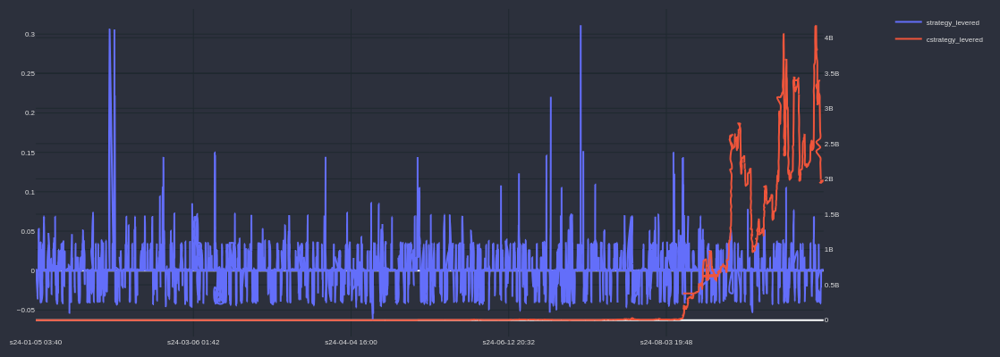

In [73]:
cp = CandlePlot(df_filtered, candles=False)
cp.show_plot(line_traces = ['strategy_levered'], sec_traces=['cstrategy_levered'])

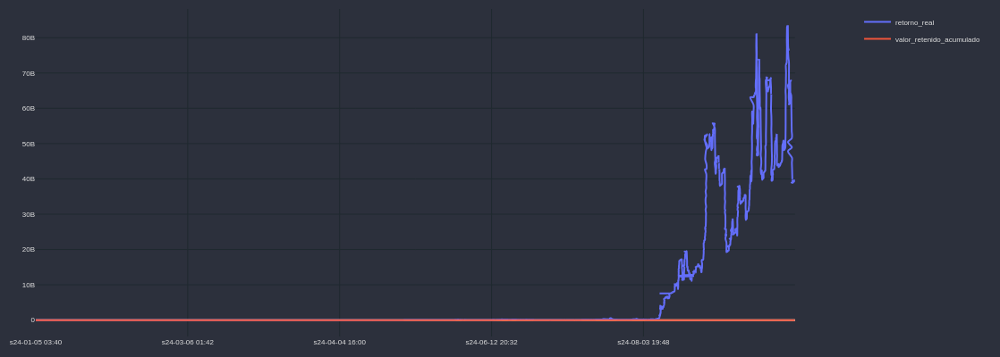

In [74]:
cp = CandlePlot(df_filtered, candles=False)
cp.show_plot(line_traces = ['retorno_real','valor_retenido_acumulado'])

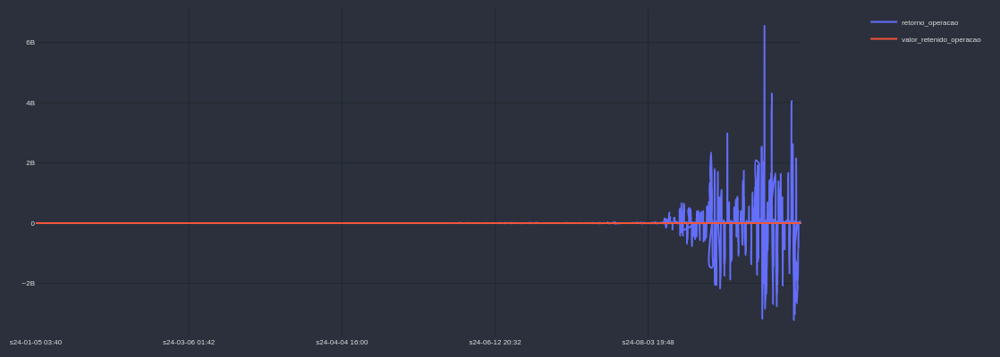

In [75]:
cp = CandlePlot(df_filtered, candles=False)
cp.show_plot(line_traces = ['retorno_operacao','valor_retenido_operacao'])

In [76]:
df_filtered.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'stop_loss_percent', 'trailing_stop_target', 'trailing_stop_loss',
       'type', 'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN',
       'result', 'end_time', 'start_time', 'time', 'GAIN_C',
       'operacoes_simultaneas', 'session', 'session_compound', 'simple_ret',
       'eff_lev', 'retorno_real', 'valor_retenido', 'valor_retenido_acumulado',
       'strategy_levered', 'retorno_operacao', 'valor_retenido_operacao',
       'cstrategy_levered'],
      dtype='object')

In [77]:
df_filtered[['strategy','time', 'GAIN_C',
       'session', 'session_compound', 'simple_ret', 'eff_lev',
       'strategy_levered', 'cstrategy_levered','retorno_real']].tail()

,strategy,time,GAIN_C,session,session_compound,simple_ret,eff_lev,strategy_levered,cstrategy_levered,retorno_real
17381,0.000472,2024-09-30 13:55:00,21.408189,841.0,0.124234,0.000472,1.0,0.000472,1.983618e+09,3.967237e+10
17382,0.000200,2024-09-30 13:20:00,21.408389,842.0,0.111974,0.000200,1.0,0.000200,1.984015e+09,3.968030e+10
17383,0.000200,2024-09-30 22:17:00,21.408589,843.0,0.031464,0.000200,1.0,0.000200,1.984412e+09,3.968824e+10
17384,0.000200,2024-09-30 16:54:00,21.408789,844.0,0.031695,0.000200,1.0,0.000200,1.984809e+09,3.969618e+10
17385,0.000200,2024-09-30 18:07:00,21.408989,845.0,0.046120,0.000200,1.0,0.000200,1.985206e+09,3.970412e+10


In [78]:
max(df_filtered.eff_lev), min(df_filtered.eff_lev)

(1.0, 1.0)

In [151]:
import numpy as np
import pandas as pd

def calcular_retorno_dinamico_com_alavancagem(df, saldo_total, alavancagem=1, percentual_capital=10):
    """
    Calcula o retorno acumulado em dólar com controle de reserva, considerando operações simultâneas e mantendo
    o saldo total inalterado até que as operações sejam fechadas. Adiciona incremento de 2% ao capital usado.

    Parâmetros:
        df (pd.DataFrame): DataFrame contendo as colunas `start_time`, `end_time`, e `strategy`.
        saldo_total (float): Saldo total inicial disponível para operações.
        alavancagem (float): Fator de alavancagem a ser aplicado nas operações.
        percentual_capital (float): Percentual do saldo total a ser usado em cada operação.

    Retorno:
        pd.DataFrame: DataFrame atualizado com colunas adicionais e métricas.
    """
    # Ordenar o DataFrame pelo tempo de abertura
    df = df.sort_values(by="start_time").reset_index(drop=True)

    # Inicializar arrays e variáveis
    n = len(df)
    capital_usado = saldo_total / percentual_capital
    incremento_percentual = 0.01

    status = np.full(n, "fechada", dtype=object)
    retorno_dolar = np.zeros(n)
    capital_acumulado = np.full(n, saldo_total)
    saldo_total_arr = np.full(n, saldo_total)
    capital_usado_arr = np.zeros(n)

    for i in range(n):
        # Fechar operações cujo end_time já passou
        abertas = (status == "aberta") & (df["end_time"].values <= df["start_time"].iloc[i])
        for j in np.where(abertas)[0]:
            retorno_alavancado = alavancagem * (df["strategy"].iloc[j] * capital_usado_arr[j])
            saldo_total += retorno_alavancado  # Atualizar saldo total com o retorno da operação
            retorno_dolar[j] = retorno_alavancado
            status[j] = "fechada"
            # Recalcular o capital usado após fechar uma operação
            capital_usado = saldo_total / percentual_capital

        # Incrementar o capital usado em 2% para a nova operação
        capital_usado *= (1 + incremento_percentual)
        capital_usado_arr[i] = capital_usado

        # Marcar a operação como aberta
        status[i] = "aberta"

        # Atualizar o saldo acumulado e saldo total
        saldo_total_arr[i] = saldo_total
        capital_acumulado[i] = saldo_total

    # Adicionar os resultados ao DataFrame
    df["capital_usado"] = capital_usado_arr
    df["retorno_dolar"] = retorno_dolar
    df["capital_acumulado"] = capital_acumulado
    df["saldo_total"] = saldo_total_arr
    df["status"] = status

    print("Resumo Final:")
    print(f"Saldo total final: ${saldo_total:.2f}")
    return df


In [152]:
df_op_si = df_filtered[df_filtered.operacoes_simultaneas < 10]
df_op_si.shape, df_op_si.strategy.sum()

((2355, 34), np.float64(3.3950554387533165))

In [153]:
df_filtered.strategy.sum()

np.float64(21.408988510491408)

In [154]:
# valor_inicial = 5.0
saldo_total = 1000.0

# Exemplo de uso com alavancagem
df_resultado_dinamico_alavancagem = calcular_retorno_dinamico_com_alavancagem(
    df_filtered, saldo_total, alavancagem=20, percentual_capital=80
)

Resumo Final:
Saldo total final: $40453.74


In [142]:
df_resultado_dinamico_alavancagem[["start_time", "end_time", "strategy", "capital_usado", "retorno_dolar",
              "capital_acumulado", "saldo_total"]].head(2500)

,start_time,end_time,strategy,capital_usado,retorno_dolar,capital_acumulado,saldo_total
0,2024-01-05 02:12:00,2024-01-05 03:40:00,0.000765,12.750000,0.194957,1000.000000,1000.000000
1,2024-01-05 02:17:00,2024-01-05 03:09:00,0.000200,13.005000,0.052020,1000.000000,1000.000000
2,2024-01-05 02:37:00,2024-01-05 03:06:00,0.000766,13.265100,0.203122,1000.000000,1000.000000
3,2024-01-05 02:38:00,2024-01-05 05:54:00,0.000417,13.530402,0.112749,1000.000000,1000.000000
4,2024-01-05 02:41:00,2024-01-05 05:53:00,0.000200,13.801010,0.055204,1000.000000,1000.000000
5,2024-01-05 02:42:00,2024-01-05 09:09:00,0.000200,14.077030,0.056308,1000.000000,1000.000000
6,2024-01-05 02:42:00,2024-01-05 09:09:00,0.000200,14.358571,0.057434,1000.000000,1000.000000
7,2024-01-05 02:42:00,2024-01-05 09:09:00,0.000200,14.645742,0.058583,1000.000000,1000.000000
8,2024-01-05 02:43:00,2024-01-05 06:29:00,0.000574,14.938657,0.171604,1000.000000,1000.000000
9,2024-01-05 02:43:00,2024-01-05 06:29:00,0.000574,15.237430,0.175036,1000.000000,1000.000000


In [84]:
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_usado'], sec_traces=['retorno_dolar'])

In [85]:
df_resultado_dinamico_alavancagem['cstrategy'] = df_resultado_dinamico_alavancagem.strategy.cumsum()
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_acumulado'], sec_traces=['cstrategy'], height=1100)